<a href="https://colab.research.google.com/github/jr23data/Red_Neuronal/blob/master/Test_A_Cientifico_de_datos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Test A científico de datos: Prueba reconocimiento de genero

Considere el set de datos de rostros:

https://drive.google.com/file/d/1n92GpGfMnxvl8aswW3bFXuDYMXvtd037/view?usp=sharing

Crear un modelo usando una red neuronal convolucional para determinar si un rostro pertenece a un hombre o a una mujer.


Requisitos:

Python, TensorflowKeras API, Jupyter notebook

Debe entregar el Jupyter notebook donde esté el código de limpiado de los datos,
entrenamiento del modelo y evaluación.

Debe explicar porqué lo hizo de esa manera.

Debe describir de los pasos lo más posible.

Subir a github y compartir el enlace.

In [ ]:
#Primero cargo el dataset
from google.colab import files
uploaded = files.upload()

Saving genero.zip to genero.zip


In [ ]:
#Con esta linea veo en que carpeta se guardó el archivo
!pwd

/content


In [ ]:
#Descomprimo el archivo 
import zipfile
import io
data = zipfile.ZipFile(io.BytesIO(uploaded['genero.zip']), 'r')
data.extractall()

In [ ]:
#Librerias que utilizo
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

In [ ]:
#Existen 2 subcarpetas una con rostros de hombres y otra con rostros de mujeres, entonces cada una la voy a asignar a una variable
man = '/content/genero/man'
man_trianing = [] #Armo una lista con cada registro de rostro de hombres
img_size = 80 #Despues de probar con tamaños mas grandes y mas pequeños, el tamaño ideal para este ejercicio es en 80 pixeles
for img in os.listdir(man):
  img = cv2.imread(os.path.join(man, img))
  img_resize = cv2.resize(img, (img_size,img_size)) #Aqui le damos la forma de arreglo que conviene
  man_trianing.append(img_resize) #Finalmente voy agregando cada item a la lista

In [ ]:
#Mestro el numero de elementos de mi lista y muestro los primeros 3 arreglos
print(len(man_trianing))
man_trianing[:3]

800


[array([[[  6,  10,  35],
         [  4,   9,  34],
         [ 41,  41,  67],
         ...,
         [ 42,  84, 123],
         [ 55, 107, 147],
         [ 66, 125, 165]],
 
        [[ 42,  58,  85],
         [ 36,  52,  78],
         [ 68,  78, 105],
         ...,
         [ 24,  62,  96],
         [ 41,  88, 125],
         [ 44,  97, 135]],
 
        [[ 55,  86, 114],
         [ 57,  86, 113],
         [ 65,  90, 118],
         ...,
         [ 15,  43,  71],
         [ 21,  58,  91],
         [ 23,  65, 100]],
 
        ...,
 
        [[ 27,  81, 177],
         [ 23,  79, 175],
         [ 20,  78, 173],
         ...,
         [ 24,  52,  91],
         [ 26,  52,  89],
         [ 25,  51,  89]],
 
        [[ 28,  80, 179],
         [ 25,  80, 178],
         [ 22,  80, 176],
         ...,
         [ 25,  54,  93],
         [ 26,  54,  91],
         [ 25,  53,  90]],
 
        [[ 26,  81, 180],
         [ 23,  78, 177],
         [ 19,  76, 175],
         ...,
         [ 26,  57,  96],
  

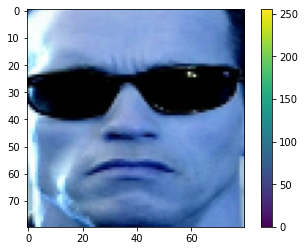

In [ ]:
#Grafico al azar alguno de los registros de ésta lista
plt.figure()
plt.imshow(np.squeeze(man_trianing[8])) #Pasamos este metodo para hacer matrices unidimensionales
plt.colorbar()
plt.grid(False)
plt.show()

In [ ]:
#Y aqui podemos ver que la forma del arreglo es adecuada
mens = np.array(man_trianing)
mens.shape

(800, 80, 80, 3)

In [ ]:
#Repetimos los pasos ahora con la subcarpeta de rostros de mujeres
woman = '/content/genero/woman'
woman_trianing = []
img_size = 80
for img in os.listdir(woman):
  img = cv2.imread(os.path.join(woman, img))
  img_resize = cv2.resize(img, (img_size,img_size))
  woman_trianing.append(img_resize)

In [ ]:
#Mismas consideraciones que con los hombres
print(len(woman_trianing))
woman_trianing[:3]

800


[array([[[ 16,  16,  40],
         [ 14,  10,  36],
         [ 10,   7,  32],
         ...,
         [  5,   5,  23],
         [  4,   4,  22],
         [  3,   3,  22]],
 
        [[ 11,   9,  34],
         [  4,   1,  26],
         [ 13,  10,  35],
         ...,
         [  1,   1,  16],
         [  2,   3,  18],
         [  2,   2,  19]],
 
        [[  4,   4,  28],
         [ 13,  10,  36],
         [ 22,  19,  45],
         ...,
         [  1,   1,  12],
         [  2,   2,  14],
         [  0,   1,  12]],
 
        ...,
 
        [[ 82, 104, 182],
         [ 82, 104, 182],
         [ 78, 100, 179],
         ...,
         [151, 175, 217],
         [154, 179, 219],
         [154, 179, 219]],
 
        [[ 78, 102, 177],
         [ 79, 101, 179],
         [ 77,  99, 177],
         ...,
         [151, 175, 217],
         [155, 180, 220],
         [156, 181, 220]],
 
        [[ 77, 100, 176],
         [ 77, 100, 176],
         [ 76,  99, 175],
         ...,
         [151, 175, 217],
  

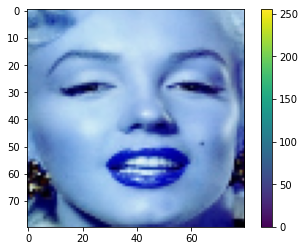

In [ ]:
#Tambien una visualización al azar
plt.figure()
plt.imshow(np.squeeze(woman_trianing[33]))
plt.colorbar()
plt.grid(False)
plt.show()

In [ ]:
#Arreglo adecuado
womans = np.array(woman_trianing)
womans.shape

(800, 80, 80, 3)

In [ ]:
#Concateno ambas listas y reafirmo la forma del arreglo
images = np.concatenate([woman_trianing, man_trianing])
print(len(images))
Images = np.array(images)
print(Images.shape)

1600
(1600, 80, 80, 3)


In [ ]:
#Hago un arreglo con la clasificación de 0 para las mujeres
labels_woman = np.repeat(0,800)
print(len(labels_woman))
print(labels_woman)

800
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 

In [ ]:
#Arreglo de etiquetas para calisificación de 1 para los hombres.
labels_man = np.repeat(1,800)
print(len(labels_man))
print(labels_man)

800
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 

In [ ]:
#Nombres de calsificación
img_names = ['Mujer', 'Hombre']

In [ ]:
#Concateno tambien las etiquetas de clasificación
labels = np.concatenate([labels_woman, labels_man])
print(len(labels))
print(labels)
Labels = np.array(labels)
print(Labels.shape)

1600
[0 0 0 ... 1 1 1]
(1600,)


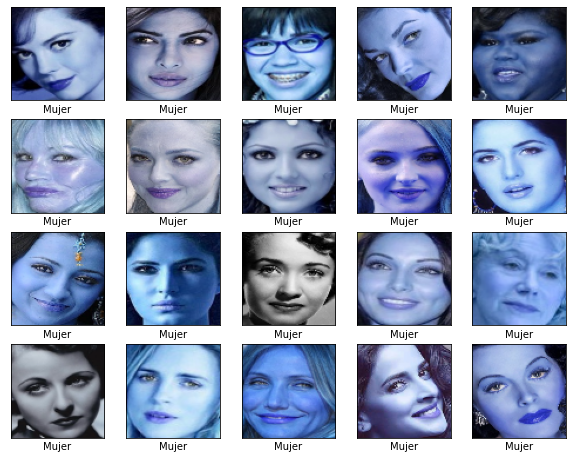

In [ ]:
#Visualizacion de una muestra de rostros de mujer (items del 0 al 799 de la lista)
plt.figure(figsize=(10,10))
for i in range(20): #Iteración para graficar las muestras
  plt.subplot(5,5,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.grid(False)
  plt.imshow(Images[i])
  #cmap = plt.cm.binary
  plt.xlabel(img_names[Labels[i]])
plt.show()

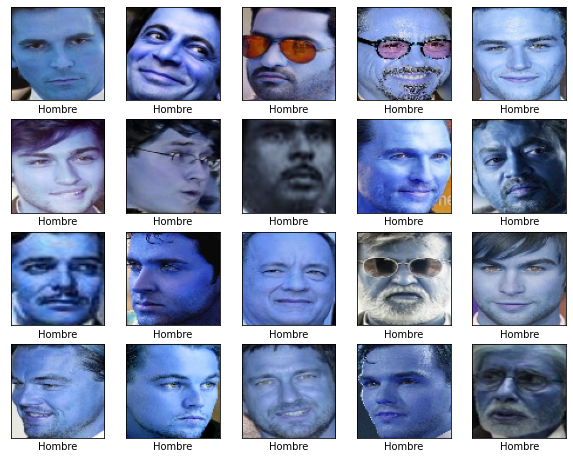

In [ ]:
#Ahora una muestra con los hombres ( registros del 800 al 1599 de la lista)
plt.figure(figsize=(10,10))
for i in range(20):
  plt.subplot(5,5,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.grid(False)
  plt.imshow(Images[1000+i]) #Sumo 1000 para asegurarme que estoy en rangos de rostros de hombres
  #cmap = plt.cm.binary
  plt.xlabel(img_names[Labels[1000+i]])
plt.show()

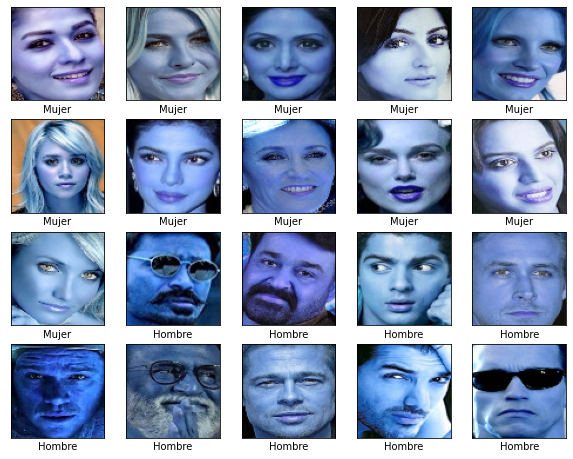

In [ ]:
#Muestra de la interseccion de hombres y mujeres ( ultimas 10 mujeres, primeros 10 hombres)
plt.figure(figsize=(10,10))
for i in range(20):
  plt.subplot(5,5,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.grid(False)
  plt.imshow(Images[789+i])
  #cmap = plt.cm.binary
  plt.xlabel(img_names[Labels[789+i]])
plt.show()

In [ ]:
#Importamos la libreria de tensorflow y nos aseguramos de la versión
from re import X
from __future__ import absolute_import, division, print_function, unicode_literals
varibale_name = ''
try:
  %tensorflow_version 2.x
except Exception:
  pass

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import datasets,layers, models
import tensorflow.keras.optimizers as Optimizer
print(tf.__version__)

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.
2.9.2


In [ ]:
#Creo un primer modelo de 128 neuronas para mis 2 clasificadores usando el activaciones que nos convienen de inicio.
from tensorflow.python import metrics #Importo metricas de tensorflow
model = keras.Sequential([
    keras.layers.Flatten(input_shape =( 80, 80, 3)),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(2,activation='softmax')
])
model.compile(optimizer='adam', #Compilo el modelo
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
tensorboard = TensorBoard(log_dir='logs/inicial') #La variable de tensorboard se envia en el arreglo de "callbacks" 
model.fit(Images, Labels, epochs=50, callbacks=[tensorboard]) #Propongo iniciar con 50 epocas y regreso la llamada al tensorboard
#Guardo los resultados en la carpeta indicada en cada epoca, de manera que despues Tensorboard los lee para hacer graficas

Epoch 1/50
50/50 [==============================] - 2s 25ms/step - loss: 616.2213 - accuracy: 0.6775
Epoch 2/50
50/50 [==============================] - 1s 24ms/step - loss: 67.9579 - accuracy: 0.7975
Epoch 3/50
50/50 [==============================] - 1s 23ms/step - loss: 96.2282 - accuracy: 0.7944
Epoch 4/50
50/50 [==============================] - 1s 24ms/step - loss: 83.4007 - accuracy: 0.8062
Epoch 5/50
50/50 [==============================] - 1s 24ms/step - loss: 62.6411 - accuracy: 0.8194
Epoch 6/50
50/50 [==============================] - 1s 24ms/step - loss: 92.7597 - accuracy: 0.8000
Epoch 7/50
50/50 [==============================] - 1s 24ms/step - loss: 76.8646 - accuracy: 0.8156
Epoch 8/50
50/50 [==============================] - 1s 24ms/step - loss: 67.2632 - accuracy: 0.8431
Epoch 9/50
50/50 [==============================] - 1s 23ms/step - loss: 99.5359 - accuracy: 0.8056
Epoch 10/50
50/50 [==============================] - 1s 24ms/step - loss: 31.5006 - accuracy: 0.902

In [ ]:
#Importo TensorBoard de TensorFlow
from tensorflow.keras.callbacks import TensorBoard

In [ ]:
#Cargo la extension de tensorboard
%load_ext tensorboard

In [ ]:
#Ejecuto tensorboard para graficar lo que haya en la carpeta "logs"
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

Le fue bastante bien al modelo pero es muy evidente que apenas esta aprendiendo, tiene muchas areas de oportunidad.

Voy a proponer mas capas y adecuaciones para encontrar el modelo mas eficiente.

In [ ]:
#Primero un modelo Denso con 2 capas de 150 neuronas con activación 'relu'
modeloDenso = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(80, 80, 3)),
  tf.keras.layers.Dense(150, activation='relu'),
  tf.keras.layers.Dense(150, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid') #Propongo activaión 'sigmund' en el clasificador por que solo se trata de 0's y 1's
])

#Ahora un modelo convolucional con de 32, 64 y 128 neuronas y con matrices de 2 dimensiones de 3x3 y de de 2x2, con activación 'relu' para que encuentre la mejor solución
modeloCNN = tf.keras.models.Sequential([
  tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(80, 80, 3)),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),

  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(100, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid') #Propongo activaión 'sigmund' en el clasificador por que solo se trata de 0's y 1's
])

In [ ]:
#Compilo los modelos
modeloDenso.compile(optimizer='adam',
                    loss='binary_crossentropy',
                    metrics=['accuracy'])

modeloCNN.compile(optimizer='adam',
                    loss='binary_crossentropy',
                    metrics=['accuracy'])

In [ ]:
#Entreno el modelo Denso con splits de 15% y con tamaños de lotes de 32, a 100 epocas
tensorboardDenso = TensorBoard(log_dir='logs/denso')
modeloDenso.fit(Images, Labels, batch_size=32,
                validation_split=0.15,
                epochs=100,
                callbacks=[tensorboardDenso])

Epoch 1/100
43/43 [==============================] - 2s 39ms/step - loss: 275.4964 - accuracy: 0.6147 - val_loss: 162.9980 - val_accuracy: 0.2083
Epoch 2/100
43/43 [==============================] - 1s 34ms/step - loss: 36.2867 - accuracy: 0.7478 - val_loss: 193.2258 - val_accuracy: 0.1792
Epoch 3/100
43/43 [==============================] - 2s 35ms/step - loss: 32.2619 - accuracy: 0.7596 - val_loss: 22.0263 - val_accuracy: 0.7917
Epoch 4/100
43/43 [==============================] - 1s 33ms/step - loss: 21.3454 - accuracy: 0.8015 - val_loss: 12.1868 - val_accuracy: 0.8458
Epoch 5/100
43/43 [==============================] - 1s 33ms/step - loss: 20.0674 - accuracy: 0.7816 - val_loss: 9.3796 - val_accuracy: 0.8792
Epoch 6/100
43/43 [==============================] - 2s 35ms/step - loss: 21.3495 - accuracy: 0.7875 - val_loss: 247.1696 - val_accuracy: 0.0708
Epoch 7/100
43/43 [==============================] - 1s 33ms/step - loss: 23.7075 - accuracy: 0.8007 - val_loss: 0.3942 - val_accurac

In [ ]:
#Ahora entreno el modelo Convolucional con los mismos parametros y en ambos casos guardo los resultados en la carpeta 'logs'
tensorboardCNN = TensorBoard(log_dir='logs/cnn')
modeloCNN.fit(Images, Labels, batch_size=32,
                validation_split=0.15,
                epochs=100,
                callbacks=[tensorboardCNN])

Epoch 1/100
43/43 [==============================] - 19s 422ms/step - loss: 8.1657 - accuracy: 0.6294 - val_loss: 0.5103 - val_accuracy: 0.7542
Epoch 2/100
43/43 [==============================] - 18s 414ms/step - loss: 0.3796 - accuracy: 0.8360 - val_loss: 1.3049 - val_accuracy: 0.4208
Epoch 3/100
43/43 [==============================] - 17s 403ms/step - loss: 0.3584 - accuracy: 0.8404 - val_loss: 0.3161 - val_accuracy: 0.8792
Epoch 4/100
43/43 [==============================] - 18s 414ms/step - loss: 0.1938 - accuracy: 0.9199 - val_loss: 0.1125 - val_accuracy: 0.9750
Epoch 5/100
43/43 [==============================] - 18s 413ms/step - loss: 0.1864 - accuracy: 0.9316 - val_loss: 0.2021 - val_accuracy: 0.9292
Epoch 6/100
43/43 [==============================] - 18s 415ms/step - loss: 0.1005 - accuracy: 0.9596 - val_loss: 0.2421 - val_accuracy: 0.9000
Epoch 7/100
43/43 [==============================] - 18s 416ms/step - loss: 0.0843 - accuracy: 0.9735 - val_loss: 0.2178 - val_accuracy:

In [ ]:
#Vuelvo cargar TensorBoard
%load_ext tensorboard

In [ ]:
#Se van graficando todos los resultados de los distintos modelos y podemos ir evaluando
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

Es muy notorio que el modelo convolucional es mas eficiente y no se sobreajusta hasta antes de de la epoca 50. esto nos sirve para optimizar recursos de computo.

Voy a hacer una ultima propuesta modificando los datos para que los modelos logren identificar rostros rotados, zoomeados, estirados e inclusoive con calidades mas bajas en relación a las imagenes con las que lo entrenamos....

In [ ]:
#Realizo el aumento de datos con varias transformaciones.
from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=15,
    zoom_range=[0.7, 1.4],
    horizontal_flip=True,
    vertical_flip=True
)

datagen.fit(Images)


In [ ]:
#Armo nuevamente los modelos con los nombres de variables correspondientes para ver en graficas
modeloDenso_AD = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(80, 80, 3)),
  tf.keras.layers.Dense(150, activation='relu'),
  tf.keras.layers.Dense(150, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])

modeloCNN_AD = tf.keras.models.Sequential([
  tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(80, 80, 3)),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(100, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])


In [ ]:
#Compilo los nuevos modelos
modeloDenso_AD.compile(optimizer='adam',
                    loss='binary_crossentropy',
                    metrics=['accuracy'])

modeloCNN_AD.compile(optimizer='adam',
                    loss='binary_crossentropy',
                    metrics=['accuracy'])


In [ ]:
#Separo los datos de entrenamiento y los datos de pruebas en variables diferentes por que al estar ordenados estamos cargando la balanza un poco, propongo 15% de cada clase para validar

X_entrenamiento = Images[:680] + Images[800:1480]
X_validacion = Images[680:800] + Images[1480:]

y_entrenamiento = Labels[:680] + Labels[800:1480]
y_validacion = Labels[680:800] + Labels[1480:]

In [ ]:
#Usar la funcion flow del generador para crear un iterador que podamos enviar como entrenamiento a la funcion FIT del modelo
data_gen_entrenamiento = datagen.flow(X_entrenamiento, y_entrenamiento, batch_size=32)

In [ ]:
#Este codigo se puede ocupar si la capacidad de procesamiento se satura, lo que hace es limpirar la basura por asi decirlo

# import gc
# gc.collect()

68312

In [ ]:
#Entreno el modelo denso con Aumento (Modificación) de Datos
tensorboardDenso_AD = TensorBoard(log_dir='logs/denso_AD')

modeloDenso_AD.fit(
    data_gen_entrenamiento,
    epochs=100, batch_size=32,
    validation_data=(X_validacion, y_validacion),
    steps_per_epoch=int(np.ceil(len(X_entrenamiento) / float(32))),
    validation_steps=int(np.ceil(len(X_validacion) / float(32))),
    callbacks=[tensorboardDenso_AD]
)

Epoch 1/100
22/22 [==============================] - 3s 92ms/step - loss: 5.3581 - accuracy: 0.9529 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 2/100
22/22 [==============================] - 2s 82ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 3/100
22/22 [==============================] - 2s 82ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 4/100
22/22 [==============================] - 2s 83ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/100
22/22 [==============================] - 2s 83ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/100
22/22 [==============================] - 2s 82ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/100
22/22 [==============================] - 2s 83ms/step - loss: 0.0000e+00 - accuracy: 1.0000 

In [ ]:
#Entreno el modelo convolucional con Aumento (Modificación) de Datos
tensorboardCNN_AD = TensorBoard(log_dir='logs-new/cnn_AD')

modeloCNN_AD.fit(
    data_gen_entrenamiento,
    epochs=150, batch_size=32,
    validation_data=(X_validacion, y_validacion),
    steps_per_epoch=int(np.ceil(len(X_entrenamiento) / float(32))),
    validation_steps=int(np.ceil(len(X_validacion) / float(32))),
    callbacks=[tensorboardCNN_AD]
)

Epoch 1/150
22/22 [==============================] - 11s 450ms/step - loss: 1.9865 - accuracy: 0.9529 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 2/150
22/22 [==============================] - 10s 440ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 3/150
22/22 [==============================] - 10s 444ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 4/150
22/22 [==============================] - 10s 455ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/150
22/22 [==============================] - 10s 439ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/150
22/22 [==============================] - 10s 438ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/150
22/22 [==============================] - 10s 442ms/step - loss: 0.0000e+00 - acc

In [ ]:
#Vuelvo a cargar el Tensorboard para mostrar por separadpo estos resultados
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
#Ahora mande todo a la carpeta la carpeta "logs-new"
%tensorboard --logdir logs-new # Si se desea evaluar estos modelos con el resto hay que cambiar la carpeta de recepción de "logs-new" a 'logs'

<IPython.core.display.Javascript object>

Vemos que esta sobreajustada, por tiempo ya no voy a seguir iterando y modificando modelos, pero esta es la manera de encontrar el modelo mas eficiente para este proyecto.

Finalmente voy a predecir la detección de genero usando el modelo inicial para demostrar que aun con ese modelo que esta mas ligero, tiene una efectividad notable.

In [ ]:
#Elijo un rostro dentro de los rango de mujeres
img=Images[3]
print(img.shape)
img = np.expand_dims(img,0)
print(img.shape)

(80, 80, 3)
(1, 80, 80, 3)


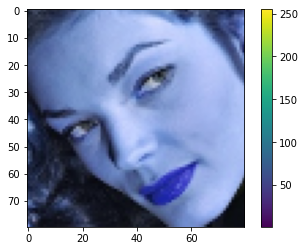

In [ ]:
#Lo muestro para que se note que si se trata de una mujer
plt.figure()
plt.imshow(Images[3])
plt.colorbar()
plt.grid(False)
plt.show()

In [ ]:
#Hago la prediccion con el modelo mas sencillo (model), imprimo también su Precisión y Finalmente que clasificación devuelve...
predictions_singles = model.predict(img)
print(predictions_singles)
print(np.sum(predictions_singles))
print(np.argmax(predictions_singles))
print(img_names[np.argmax(predictions_singles)])

1/1 [==============================] - 0s 22ms/step
[[0.9850317  0.01496822]]
0.99999994
0
Mujer


In [ ]:
#Ahora lo pruebo con una muestra de rostro de hombre
img=Images[-3]
print(img.shape)
img = np.expand_dims(img,0)
print(img.shape)

(80, 80, 3)
(1, 80, 80, 3)


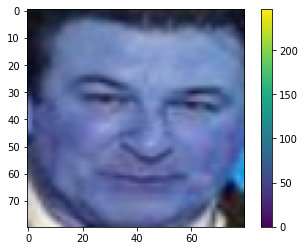

In [ ]:
#Lo muestro para estar seguro
plt.figure()
plt.imshow(Images[-3])
plt.colorbar()
plt.grid(False)
plt.show()

In [ ]:
#Corro la preddioción
predictions_singles = model.predict(img)
print(predictions_singles)
print(np.sum(predictions_singles))
print(np.argmax(predictions_singles))
print(img_names[np.argmax(predictions_singles)])

1/1 [==============================] - 0s 21ms/step
[[5.8899885e-05 9.9994111e-01]]
1.0
1
Hombre


El modelo es eficiente, ahora lo voy a probar con imagenes que no estan en nuestro conjunto de datos.

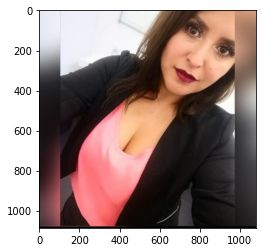

In [ ]:
#Cargo la foto de mi esposa
img=cv2.imread('/content/Lau.png')
img_cvt=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_cvt)
plt.show()

In [ ]:
#Preparo el arreglo
img2=img_cvt
img2=cv2.resize(img2,(img_size,img_size))
print(img2.shape)
img2=np.expand_dims(img2,0)
print(img2.shape)

(80, 80, 3)
(1, 80, 80, 3)


In [ ]:
#Corro la predcción
predictions_singles = model.predict(img2)
print(predictions_singles)
print(np.sum(predictions_singles))
print(np.argmax(predictions_singles))
print(img_names[np.argmax(predictions_singles)])

1/1 [==============================] - 0s 23ms/step
[[9.9999547e-01 4.5416332e-06]]
1.0
0
Mujer


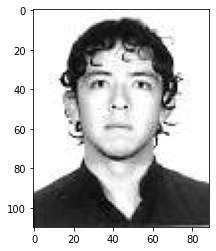

In [ ]:
#Ahora cargo una foto mia
img=cv2.imread('/content/pp.jpg')
img_cvt=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_cvt)
plt.show()

In [ ]:
#Preparo el arreglo
img2=img_cvt
img2=cv2.resize(img2,(img_size,img_size))
print(img2.shape)
img2=np.expand_dims(img2,0)
print(img2.shape)

(80, 80, 3)
(1, 80, 80, 3)


In [ ]:
#Predicción
predictions_singles = model.predict(img2)
print(predictions_singles)
print(np.sum(predictions_singles))
print(np.argmax(predictions_singles))
print(img_names[np.argmax(predictions_singles)])

1/1 [==============================] - 0s 34ms/step
[[9.1415751e-07 9.9999905e-01]]
0.99999994
1
Hombre


Aun el modelo mas sencillo es eficiente.